In [1]:
import pandas as pd
from sklearn import preprocessing
import sklearn.model_selection as ms
from sklearn import linear_model
import sklearn.metrics as sklm
import numpy as np
import numpy.random as nr
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as ss
import math
import sweetviz as sv
from tabulate import tabulate
from timeit import timeit
import matplotlib.pyplot as plt
from pandas import DataFrame
import plotly.express as px
import matplotlib
import plotly.graph_objs as go

%matplotlib inline

In [3]:
# pd.set_option('display.max_columns', None)
pd.set_option('display.max_columns', 50)
pd.set_option('display.max_rows', None)

In [4]:
df1 = pd.read_csv('ABIA_crosschecked.csv')#importing the dataset
df2 = pd.read_csv('ADAMAWA_crosschecked.csv')#importing the dataset
df3 = pd.read_csv('AKWA IBOM_crosschecked.csv')#importing the dataset
df4 = pd.read_csv('ANAMBRA_crosschecked.csv')#importing the dataset
df5 = pd.read_csv('BAUCHI_crosschecked.csv')#importing the dataset
df6 = pd.read_csv('BAYELSA_crosschecked.csv')#importing the dataset
df7 = pd.read_csv('BENUE_crosschecked.csv')#importing the dataset
df8= pd.read_csv('BORNO_crosschecked.csv')#importing the dataset
df9 = pd.read_csv('CROSS RIVER_crosschecked.csv')#importing the dataset
df10 = pd.read_csv('DELTA_crosschecked.csv')#importing the dataset
df11 = pd.read_csv('EBONYI_crosschecked.csv')#importing the dataset
df12 = pd.read_csv('EDO_crosschecked.csv')#importing the dataset
df13 = pd.read_csv('EKITI_crosschecked.csv')#importing the dataset
df14 = pd.read_csv('ENUGU_crosschecked.csv')#importing the dataset
df15 = pd.read_csv('FCT_crosschecked.csv')#importing the dataset
df16 = pd.read_csv('GOMBE_crosschecked.csv')#importing the dataset
df17 = pd.read_csv('IMO_crosschecked.csv')#importing the dataset
df18 = pd.read_csv('JIGAWA_crosschecked.csv')#importing the dataset
df19 = pd.read_csv('KADUNA_crosschecked.csv')#importing the dataset
df20 = pd.read_csv('KANO_crosschecked.csv')#importing the dataset
df21 = pd.read_csv('KATSINA_crosschecked.csv')#importing the dataset
df22 = pd.read_csv('KEBBI_crosschecked.csv')#importing the dataset
df23 = pd.read_csv('KOGI_crosschecked.csv')#importing the dataset
df24 = pd.read_csv('KWARA_crosschecked.csv')#importing the dataset
df25 = pd.read_csv('LAGOS_crosschecked.csv')#importing the dataset
df26 = pd.read_csv('NASARAWA_crosschecked.csv')#importing the dataset
df27 = pd.read_csv('NIGER_crosschecked.csv')#importing the dataset
df28 = pd.read_csv('OGUN_crosschecked.csv')#importing the dataset
df29 = pd.read_csv('ONDO_crosschecked.csv')#importing the dataset
df30 = pd.read_csv('OSUN_crosschecked.csv')#importing the dataset
df31 = pd.read_csv('OYO_crosschecked.csv')#importing the dataset
df32 = pd.read_csv('PLATEAU_crosschecked.csv')#importing the dataset
df33 = pd.read_csv('RIVERS_crosschecked.csv')#importing the dataset
df34 = pd.read_csv('SOKOTO_crosschecked.csv')#importing the dataset
df35 = pd.read_csv('TARABA_crosschecked.csv')#importing the dataset
df36 = pd.read_csv('YOBE_crosschecked.csv')#importing the dataset
df37 = pd.read_csv('ZAMFARA_crosschecked.csv')#importing the dataset

In [5]:
import pandas as pd

# Put all dataframes in a list
dfs = [df1, df2, df3, df4, df5, df6, df7, df8, df9, df10,
       df11, df12, df13, df14, df15, df16, df17, df18, df19, df20, df21, df22, df23, df24, df25, df25, df26,
       df27, df28, df29,df30, df31, df32, df33, df34, df35, df36, df37]

#  Reset the indexes of all dataframes and Concatenate all dataframes horizontally 
df = pd.concat(dfs).reset_index(drop = True)


In [5]:
df.head()

,State,LGA,Ward,PU-Code,PU-Name,Accredited_Voters,Registered_Voters,Results_Found,Transcription_Count,Result_Sheet_Stamped,Result_Sheet_Corrected,Result_Sheet_Invalid,Result_Sheet_Unclear,Result_Sheet_Unsigned,APC,LP,PDP,NNPP,Results_File
0,ABIA,ABA NORTH,EZIAMA,01-01-01-001,RAILWAY QUARTERS - RAILWAY QUARTERS I,85,968,True,-1,True,True,False,False,UNKNOWN,7,56,25,1,https://docs.inecelectionresults.net/elections...
1,ABIA,ABA NORTH,EZIAMA,01-01-01-002,RAILWAY QUARTERS - RAILWAY QUARTERS II,90,750,True,-1,False,False,False,False,UNKNOWN,0,0,0,0,https://docs.inecelectionresults.net/elections...
2,ABIA,ABA NORTH,EZIAMA,01-01-01-003,RAILWAY QUARTERS - RAILWAY QUARTERS III,105,750,True,-1,False,False,False,False,UNKNOWN,0,0,0,0,https://docs.inecelectionresults.net/elections...
3,ABIA,ABA NORTH,EZIAMA,01-01-01-005,ABIA POLY - ABIA POLY I,138,750,True,-1,False,False,False,False,UNKNOWN,0,0,0,0,https://docs.inecelectionresults.net/elections...
4,ABIA,ABA NORTH,INDUSTRIAL AREA,01-01-02-012,LEVER BROTHERS GATE- LEVER BROTHERS GATE IV,71,774,True,-1,False,False,False,False,UNKNOWN,0,71,0,0,https://docs.inecelectionresults.net/elections...


In [6]:
df.tail()

,State,LGA,Ward,PU-Code,PU-Name,Accredited_Voters,Registered_Voters,Results_Found,Transcription_Count,Result_Sheet_Stamped,Result_Sheet_Corrected,Result_Sheet_Invalid,Result_Sheet_Unclear,Result_Sheet_Unsigned,APC,LP,PDP,NNPP,Results_File
135824,ZAMFARA,MARADUN,FARU / MAGAMI,36-09-03-029,FARU /DISPENSARY,97,140,True,-1,True,True,False,False,UNKNOWN,61,2,34,0,https://inec-cvr-cache.s3.eu-west-1.amazonaws....
135825,ZAMFARA,MARADUN,JANBAKO,36-09-06-014,SHIYAR DANKADU II/KYALETA,139,498,True,-1,True,False,False,False,UNKNOWN,117,0,20,1,https://inec-cvr-cache.s3.eu-west-1.amazonaws....
135826,ZAMFARA,TALATA MAFARA,SHIYAR GALADIMA,36-12-09-044,DAN JALLABA III/ UNGUWAR ROGO/ BAKIN TRANSFORMER,190,745,True,-1,True,True,False,False,UNKNOWN,122,3,36,0,https://inec-cvr-cache.s3.eu-west-1.amazonaws....
135827,ZAMFARA,TALATA MAFARA,SHIYAR GALADIMA,36-12-09-051,TABKIN BUSAU IV/ N.D.L.E.A.,243,529,True,-1,True,False,False,False,UNKNOWN,219,0,18,1,https://inec-cvr-cache.s3.eu-west-1.amazonaws....
135828,ZAMFARA,TALATA MAFARA,SHIYAR GALADIMA,36-12-09-053,SHAGON TUKUR MANGO V/BAKIN YAR KOFA/MALLAMAWA,174,750,True,-1,True,False,False,False,UNKNOWN,133,0,34,0,https://inec-cvr-cache.s3.eu-west-1.amazonaws....


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 135829 entries, 0 to 135828
Data columns (total 19 columns):
 #   Column                  Non-Null Count   Dtype 
---  ------                  --------------   ----- 
 0   State                   135829 non-null  object
 1   LGA                     135829 non-null  object
 2   Ward                    135829 non-null  object
 3   PU-Code                 135829 non-null  object
 4   PU-Name                 135829 non-null  object
 5   Accredited_Voters       135829 non-null  int64 
 6   Registered_Voters       135829 non-null  int64 
 7   Results_Found           135829 non-null  bool  
 8   Transcription_Count     135829 non-null  int64 
 9   Result_Sheet_Stamped    135829 non-null  bool  
 10  Result_Sheet_Corrected  135829 non-null  bool  
 11  Result_Sheet_Invalid    135829 non-null  bool  
 12  Result_Sheet_Unclear    135829 non-null  bool  
 13  Result_Sheet_Unsigned   135829 non-null  object
 14  APC                     135829 non-n

# QUALITY REPORTS

In [8]:
def quality_report(df):
    """
    Description: Displays quality of data in terms of missing values, 
    unique numbers, datatypes etc.
    
    Arguments: Dataframe
    """
    dtypes = df.dtypes
    nuniq = df.T.apply(lambda x: x.nunique(), axis=1)
    total = df.isnull().sum().sort_values(ascending = False)
    percent = (df.isnull().sum()/df.isnull().count()*100).sort_values(ascending = False)
    quality_df  = pd.concat([total, percent, nuniq, dtypes], axis=1, keys=['Total NaN', 'Percent of NaN','Nunique', 'Dtype'])
    display(quality_df)


In [9]:
quality_report(df)

,Total NaN,Percent of NaN,Nunique,Dtype
State,0,0.0,37,object
Result_Sheet_Corrected,0,0.0,2,bool
NNPP,0,0.0,320,int64
PDP,0,0.0,373,int64
LP,0,0.0,541,int64
APC,0,0.0,398,int64
Result_Sheet_Unsigned,0,0.0,1,object
Result_Sheet_Unclear,0,0.0,1,bool
Result_Sheet_Invalid,0,0.0,2,bool
Result_Sheet_Stamped,0,0.0,2,bool


In [10]:
df.describe()

,Accredited_Voters,Registered_Voters,Transcription_Count,APC,LP,PDP,NNPP
count,135829.000000,135829.000000,135829.0,135829.000000,135829.000000,135829.000000,135829.000000
mean,137.301107,525.988581,-1.0,47.351979,38.688417,34.050416,7.554786
std,92.573119,356.072319,0.0,48.874297,59.933647,44.598576,26.382356
min,0.000000,0.000000,-1.0,0.000000,0.000000,0.000000,0.000000
25%,67.000000,254.000000,-1.0,9.000000,1.000000,4.000000,0.000000
50%,125.000000,523.000000,-1.0,34.000000,13.000000,15.000000,0.000000
75%,192.000000,750.000000,-1.0,71.000000,53.000000,49.000000,2.000000
max,1939.000000,11512.000000,-1.0,600.000000,600.000000,573.000000,587.000000


## STATISTICAL IMPLICATIONS

count: the number of non-null observations for each variable. In our case, there are 135,829 observations for each variable.

mean: the average value of each variable. For example, the average number of accredited voters is 137.3 and the average number of registered voters is 525.99.

std: the standard deviation of each variable, which is a measure of the variability of the data. A higher standard deviation indicates that the data points are more spread out from the mean. For example, the standard deviation for APC votes is 48.87, which is relatively high compared to the mean of 47.35.

min: the minimum value of each variable. For example, the minimum number of accredited voters is 0 and the minimum number of APC,LP,PDP,NNP votes is also 0.

25%, 50%, and 75%: the values below which the given percentage of observations fall. For example, 25% of the observations have less than or equal to 67 accredited voters, and 50% of the observations have less than or equal to 125 accredited voters.

max: the maximum value of each variable. For example, the maximum number of accredited voters is 1,939 and the APC and LP has maximum number votes of 600.

The implications of these statistics in our research questions. For example I am interested in understanding voter turnout, I want to focus on the variables related to registered and accredited voters.

Starting with the means, we can see that the mean number of Accredited_Voters is 137.3, and the mean number of Registered_Voters is 525.99. These values can give us a rough idea of the average number of voters in each area. This suggests that, on average, there were more registered voters than accredited voters in each area.

Next, we can examine the standard deviations, which are 92.57 for Accredited_Voters and 356.07 for Registered_Voters. A higher standard deviation means that the data points are more spread out from the mean, indicating greater variability in the number of registered and accredited voters across the areas in the dataset. This could mean that certain areas have significantly higher or lower voter participation compared to others, which may be worth exploring further. This indicates that the number of accredited voters can vary significantly across different areas, which may have influenced each party's results.

Looking at the quartile values, we can see that the median value for Accredited_Voters is 125, and the median value for Registered_Voters is 523. The first quartile for Accredited_Voters is 67, and the third quartile is 192. For Registered_Voters, the first quartile is 254, and the third quartile is 750. These values can give us a better understanding of the range of values for these variables, and can help us identify any potential outliers or extreme values. This suggests that there is a wide range of values for this variable, with some areas having very low numbers of accredited voters and others having much higher numbers.

In conclusion, analyzing the means, standard deviations, and quartile values of the Accredited_Voters and Registered_Voters variables can give us insights into voter turnout in our dataset and identify any areas that may have higher or lower voter participation compared to others. To analyze how these variables may have influenced each party's results, we can perform further analysis, such as correlation analysis or regression analysis, to determine the strength and direction of the relationship between these variables and each party's results.



### Exploratory Analysis and Visualization
Let's explore the data by visualizing the distribution of values in some columns of the dataset, and the relationships between columns.

I'll use libraries Matplotlib, Seaborn and Plotly for visualization.

In [ ]:
def numeric_distribution_plot(df):
    """
    Description : Gives distribution plot for all the numeric features
    in the dataframe passed
    
    Argument : Dataframe
    """
    for col in df.columns:
        if df[col].dtype != 'object':
            print(df[col].describe())
            plt.figure(figsize=(12,5))
            plt.title("Distribution of "+col)
            ax = sns.distplot(df[col].dropna())
            plt.tight_layout()
            plt.show()

In [ ]:
numeric_distribution_plot(df)

## Getting .describe() statistics for each state in the state 

In [11]:
df.groupby('State').describe()


Accredited_Voters                                               \
                        count        mean         std   min     25%    50%   
State                                                                        
ABIA                   2492.0   96.849920   76.049937   0.0   39.00   84.0   
ADAMAWA                3376.0  186.097749   93.559621   0.0  119.00  190.0   
AKWA IBOM              3979.0  139.638854   62.900741   0.0   94.00  138.0   
ANAMBRA                3679.0  115.236477   79.122946   0.0   56.00  103.0   
BAUCHI                 4753.0  160.848938  113.132522   0.0   73.00  138.0   
BAYELSA                1928.0   77.536826   59.958225   0.0   29.00   66.0   
BENUE                  4046.0  156.108997   79.017917   0.0  102.00  156.0   
BORNO                  3780.0   96.607937   75.126216   0.0   37.00   83.0   
CROSS RIVER            2782.0  138.421639   78.473155   0.0   77.00  136.0   
DELTA                  3929.0  111.381777   81.613071   0.0   43.00  104.0   
EBONYI                 2564.0  112.014821   76.169338   0.0   50.00  107.0   
EDO                    3745.0  137.506008   74.969542   0.0   78.00  137.0   
EKITI                  2246.0  127.600623   68.650526   0.0   78.00  121.0   
ENUGU                  3768.0  108.745488   84.284857   0.0   45.00   94.0   
FCT                    2507.0  166.477463  128.565155   0.0   66.50  157.0   
GOMBE                   672.0  166.322917   88.781073   0.0  100.00  151.0   
IMO                    2812.0  105.033073   72.021480   0.0   48.00  104.0   
JIGAWA                 3104.0  212.776740  111.316353   0.0  129.00  211.0   
KADUNA                 6130.0  176.885644   99.175777   0.0  103.00  177.0   
KANO                   7475.0  154.349967   98.337610   0.0   70.50  154.0   
KATSINA                5148.0  165.325369   94.935381   0.0   95.00  164.0   
KEBBI                  2712.0  159.392699   83.447859   0.0   96.00  157.0   
KOGI                   2511.0  120.478295   84.340962   0.0   59.00  121.0   
KWARA                  2518.0  173.027800   83.481624   0.0  111.00  176.0   
LAGOS                 23822.0  101.134498   66.273060   0.0   56.00   95.0   
NASARAWA               2535.0  172.040631   99.374279   0.0  106.00  172.0   
NIGER                  4394.0  152.015020   95.242761   0.0   77.25  155.0   
OGUN                   4069.0  121.394692   66.333400   0.0   70.00  112.0   
ONDO                   2686.0  154.551750   74.578563   0.0   99.00  153.5   
OSUN                   2248.0  221.686388   82.538146  11.0  161.75  220.0   
OYO                    3899.0  141.343934   75.501759   0.0   90.00  133.0   
PLATEAU                4327.0  205.989138  133.883131   0.0   98.00  197.0   
RIVERS                 4769.0   81.538897   69.574095   0.0   30.00   66.0   
SOKOTO                  132.0  173.901515   98.980286   0.0  114.50  173.0   
TARABA                  100.0  168.660000  122.380283   0.0   73.50  149.5   
YOBE                    122.0  160.229508  117.913246   0.0   75.00  151.0   
ZAMFARA                  70.0  175.614286   99.821622   2.0  100.00  167.5   

                            Registered_Voters                                 \
                75%     max             count        mean         std    min   
State                                                                          
ABIA         138.00   571.0            2492.0  475.422552  434.374296    0.0   
ADAMAWA      252.00   638.0            3376.0  534.808945  272.675616    0.0   
AKWA IBOM    181.00   461.0            3979.0  538.892938  292.830701   12.0   
ANAMBRA      159.00   582.0            3679.0  450.597445  333.768034    1.0   
BAUCHI       230.00   947.0            4753.0  500.891647  360.891218    1.0   
BAYELSA      116.00   412.0            1928.0  469.251556  303.203543    1.0   
BENUE        208.00   595.0            4046.0  541.499259  268.966611    1.0   
BORNO        138.00   680.0            3780.0  492.531217  360.190998    0.0   
CROSS RIVER

In [13]:
summary= df.groupby('State').describe()

#  Comparing the mean, standard deviation, minimum, and maximum values for each state to see how they compare across different parties

In [14]:
# Group the DataFrame by state
grouped = df.groupby('State')


# Calculate the highest and lowest mean, standard deviation, minimum, and maximum values for each state
result = grouped[['APC', 'LP', 'PDP', 'NNPP']].describe().loc[:, (slice(None), ['mean', 'std', 'min', 'max'])]
result.columns = result.columns.map('_'.join)

In [15]:
# Find the highest and lowest values for each state
highest = result.idxmax().to_frame().T
lowest = result.idxmin().to_frame().T

In [16]:
lowest

,APC_mean,APC_std,APC_min,APC_max,LP_mean,LP_std,LP_min,LP_max,PDP_mean,PDP_std,PDP_min,PDP_max,NNPP_mean,NNPP_std,NNPP_min,NNPP_max
0,ANAMBRA,ANAMBRA,ABIA,TARABA,ZAMFARA,ZAMFARA,ABIA,ZAMFARA,ANAMBRA,ENUGU,ABIA,EBONYI,ONDO,IMO,ABIA,SOKOTO


In [17]:
highest

,APC_mean,APC_std,APC_min,APC_max,LP_mean,LP_std,LP_min,LP_max,PDP_mean,PDP_std,PDP_min,PDP_max,NNPP_mean,NNPP_std,NNPP_min,NNPP_max
0,ZAMFARA,ZAMFARA,SOKOTO,IMO,ANAMBRA,PLATEAU,ABIA,DELTA,OSUN,YOBE,SOKOTO,KANO,KANO,KANO,ABIA,KANO


In [18]:
# Group by state and calculate summary statistics
grouped_df = df.groupby('State')[['APC', 'PDP', 'LP', 'NNPP','Accredited_Voters', 'Registered_Voters','Transcription_Count']].describe()

In [19]:
# Select relevant columns
stats_df = grouped_df[[('APC', 'mean'), ('APC', 'std'), ('APC', 'min'), ('APC', 'max'),
                       ('PDP', 'mean'), ('PDP', 'std'), ('PDP', 'min'), ('PDP', 'max'),
                       ('LP', 'mean'), ('LP', 'std'), ('LP', 'min'), ('LP', 'max'),
                       ('NNPP', 'mean'), ('NNPP', 'std'), ('NNPP', 'min'), ('NNPP', 'max'),
                       ('Accredited_Voters', 'mean'),('Accredited_Voters', 'std'),
                       ('Accredited_Voters', 'min'),('Accredited_Voters', 'max'),
                       ('Registered_Voters', 'mean'),('Registered_Voters', 'std'),
                       ('Registered_Voters', 'min'),('Registered_Voters', 'max'),
                       ('Transcription_Count','mean'),('Transcription_Count','std'),
                       ('Transcription_Count','min'),('Transcription_Count','max')]]


In [20]:
# Rename columns
stats_df.columns = ['APC_mean', 'APC_std', 'APC_min', 'APC_max',
                    'PDP_mean', 'PDP_std', 'PDP_min', 'PDP_max',
                    'LP_mean', 'LP_std', 'LP_min', 'LP_max',
                    'NNPP_mean', 'NNPP_std', 'NNPP_min', 'NNPP_max',
                    'Accredited_Voters_mean','Accredited_Voters_std',
                    'Accredited_Voters_min','Accredited_Voters_max',
                    'Registered_Voters_mean','Registered_Voters_std',
                    'Registered_Voters_min','Registered_Voters_max',
                    'Transcription_Count_mean','Transcription_Count_std',
                    'Transcription_Count_min','Transcription_Count_max']

In [21]:
# Get state with highest and lowest values for each column
highest = stats_df.idxmax()
lowest = stats_df.idxmin()

In [22]:
# Combine highest and lowest values into a single DataFrame
result_df = pd.concat([highest, lowest], axis=1, keys=['highest', 'lowest'])

# Print table
print(tabulate(result_df, headers='keys', tablefmt='psql'))



+--------------------------+-----------+----------+
|                          | highest   | lowest   |
|--------------------------+-----------+----------|
| APC_mean                 | ZAMFARA   | ANAMBRA  |
| APC_std                  | ZAMFARA   | ANAMBRA  |
| APC_min                  | SOKOTO    | ABIA     |
| APC_max                  | IMO       | TARABA   |
| PDP_mean                 | OSUN      | ANAMBRA  |
| PDP_std                  | YOBE      | ENUGU    |
| PDP_min                  | SOKOTO    | ABIA     |
| PDP_max                  | KANO      | EBONYI   |
| LP_mean                  | ANAMBRA   | ZAMFARA  |
| LP_std                   | PLATEAU   | ZAMFARA  |
| LP_min                   | ABIA      | ABIA     |
| LP_max                   | DELTA     | ZAMFARA  |
| NNPP_mean                | KANO      | ONDO     |
| NNPP_std                 | KANO      | IMO      |
| NNPP_min                 | ABIA      | ABIA     |
| NNPP_max                 | KANO      | SOKOTO   |
| Accredited

In [23]:
# Combine highest and lowest values into a single DataFrame
result_df = pd.concat([highest, lowest], axis=1, keys=['highest', 'lowest'])

# Print table
print(result_df)

                           highest   lowest
APC_mean                   ZAMFARA  ANAMBRA
APC_std                    ZAMFARA  ANAMBRA
APC_min                     SOKOTO     ABIA
APC_max                        IMO   TARABA
PDP_mean                      OSUN  ANAMBRA
PDP_std                       YOBE    ENUGU
PDP_min                     SOKOTO     ABIA
PDP_max                       KANO   EBONYI
LP_mean                    ANAMBRA  ZAMFARA
LP_std                     PLATEAU  ZAMFARA
LP_min                        ABIA     ABIA
LP_max                       DELTA  ZAMFARA
NNPP_mean                     KANO     ONDO
NNPP_std                      KANO      IMO
NNPP_min                      ABIA     ABIA
NNPP_max                      KANO   SOKOTO
Accredited_Voters_mean        OSUN  BAYELSA
Accredited_Voters_std      PLATEAU  BAYELSA
Accredited_Voters_min         OSUN     ABIA
Accredited_Voters_max     NASARAWA  BAYELSA
Registered_Voters_mean      TARABA    EKITI
Registered_Voters_std       RIVE

In [24]:
# Get state with highest and lowest values for each column
highest = stats_df.idxmax()
lowest = stats_df.idxmin()

# Get the highest and lowest values for each state
highest_values = stats_df.max()
lowest_values = stats_df.min()

# Combine highest and lowest values into a single DataFrame
result_df = pd.concat([highest, highest_values, lowest, lowest_values], axis=1,
                      keys=['highest', 'highest_values', 'lowest', 'lowest_values'])

# Print table
print(tabulate(result_df, headers='keys', tablefmt='psql'))
# This code should print a table showing the state with the highest and lowest mean, standard deviation, minimum, and maximum values for APC, PDP, LP, and NNPP, as well as the actual highest and lowest values for each state.




+--------------------------+-----------+------------------+----------+-----------------+
|                          | highest   |   highest_values | lowest   |   lowest_values |
|--------------------------+-----------+------------------+----------+-----------------|
| APC_mean                 | ZAMFARA   |         108.5    | ANAMBRA  |        1.26067  |
| APC_std                  | ZAMFARA   |          81.8774 | ANAMBRA  |        7.91037  |
| APC_min                  | SOKOTO    |           2      | ABIA     |        0        |
| APC_max                  | IMO       |         600      | TARABA   |      231        |
| PDP_mean                 | OSUN      |          98.3799 | ANAMBRA  |        2.41397  |
| PDP_std                  | YOBE      |          78.3499 | ENUGU    |        8.3763   |
| PDP_min                  | SOKOTO    |          11      | ABIA     |        0        |
| PDP_max                  | KANO      |         573      | EBONYI   |      123        |
| LP_mean            

In [25]:
# Combine highest and lowest values into a single DataFrame
result_df = pd.concat([highest, highest_values, lowest, lowest_values], axis=1,
                      keys=['highest', 'highest_values', 'lowest', 'lowest_values'])

# Print table
print(result_df)

                           highest  highest_values   lowest  lowest_values
APC_mean                   ZAMFARA      108.500000  ANAMBRA       1.260669
APC_std                    ZAMFARA       81.877383  ANAMBRA       7.910370
APC_min                     SOKOTO        2.000000     ABIA       0.000000
APC_max                        IMO      600.000000   TARABA     231.000000
PDP_mean                      OSUN       98.379893  ANAMBRA       2.413971
PDP_std                       YOBE       78.349853    ENUGU       8.376301
PDP_min                     SOKOTO       11.000000     ABIA       0.000000
PDP_max                       KANO      573.000000   EBONYI     123.000000
LP_mean                    ANAMBRA      103.258766  ZAMFARA       0.242857
LP_std                     PLATEAU      104.755629  ZAMFARA       0.769636
LP_min                        ABIA        0.000000     ABIA       0.000000
LP_max                       DELTA      600.000000  ZAMFARA       4.000000
NNPP_mean                

# Here are the results of the comparison:

For all the states

For APC, Zamfara has the highest mean (108.500000) while ANAMBRA has the lowest (1.260669).
The standard deviation for accredited voters is generally high across all states, with values ranging from 0 to  104.755629.
For all parties, Nasarawa has the highest maximum accredited voters, while Bayelsa has the lowest. 
The range between the minimum and maximum values for each state is generally large, indicating significant differences in accredited voters across different states.




The higher mean accredited voters in Nasarawa compared to Bayelsa for all parties could suggest that Nasaraw has a larger voter population and may be more influential in determining election outcomes.

The higher range of values for accredited voters and registered voters across all states could indicate that there are significant disparities in voter registration and turnout across different regions in Nigeria.

The lower standard deviation for transcription count across all states compared to the other variables suggests that there is less variation in the number of transcription errors made during vote counting.

The inconsistent trend of different highest maximum and mean values for all parties across all variables suggests that each party has their own key state in the concluded Nigerian political lanscape e.g APC_mean is ZAMFARA with a value of 108.500000, PDP_mean  is OSUN with a value of  98.379893, LP_mean is ANAMBRA with a value of 103.258766, NNPP_mean is KANO with a value of 87.921873
This suggests that each party candidates has a major state that voted for them greatlty, this means those candidates must have something unique or common for thrm to tun out well to vote 

The lower mean transcription count could indicate that the counting process in all states was less prone to errors or that there were less invalid votes that needed to be transcribed.

All in all, these statistical values can provide insight into the strengths and weaknesses of different political parties in Nigeria and the distribution of voter populations across different regions. 



# VOTERS TURNOUTS

We then calculate the percentage turnout by dividing the Accredited Voters by the Registered Voters and multiplying the result by 100.

For example, let's say that the mean Accredited Voters and Registered Voters for a particular state is 1000 and 2000, respectively. This means that on average, 1000 people were accredited to vote in that state, and 2000 people were registered to vote. The percentage turnout for that state would be (1000 / 2000) * 100 = 50%.

That means I can compare the percentage turnout for each state and see which states had the highest and lowest voter turnout.

As for the variables related to the political parties, I can use the mean of each column for APC, LP, PDP, and NNPP to get an idea of how many votes each party received on average in each state. I can then compare the means across different states to see which parties were more popular in which states. You can also calculate the correlation between each pair of variables to see how strongly they are related. For example, you can calculate the correlation between Accredited Voters and APC to see if there is a strong relationship between the number of accredited voters and the number of votes APC received.

In [26]:
# Calculate the percentage turnout for each state
df['turnout'] = (df['Accredited_Voters'] / df['Registered_Voters']) * 100

# Find the states with the highest and lowest voter turnout
highest_turnout = df.sort_values(by='turnout', ascending=False).iloc[0]
lowest_turnout = df.sort_values(by='turnout', ascending=True).iloc[0]

# Calculate the mean number of votes for each party in each state
party_means = df[['APC', 'LP', 'PDP', 'NNPP']].mean()

# Calculate the mean number of votes for each party by state
state_party_means = df.groupby('State')[['APC', 'LP', 'PDP', 'NNPP']].mean()

# Print the results
print("State with highest turnout:")
print(highest_turnout['State'])
print()
print("State with lowest turnout:")
print(lowest_turnout['State'])
print()
print("Mean number of votes for each party:")
print(party_means)
print()
print("Mean number of votes for each party by state:")
print(state_party_means)


State with highest turnout:
NIGER

State with lowest turnout:
FCT

Mean number of votes for each party:
APC     47.351979
LP      38.688417
PDP     34.050416
NNPP     7.554786
dtype: float64

Mean number of votes for each party by state:
                    APC          LP        PDP       NNPP
State                                                    
ABIA           2.926565   78.174960   6.633226   0.392055
ADAMAWA       44.139218   25.399289  97.461493   2.460012
AKWA IBOM     37.034431   31.068610  49.373209   1.987937
ANAMBRA        1.260669  103.258766   2.413971   0.556401
BAUCHI        55.910162    5.738060  77.873974  13.494214
BAYELSA       20.762448   24.057054  32.636929   0.505187
BENUE         60.546466   59.320069  26.231587   0.999753
BORNO         46.952381    2.241534  36.556085   0.915344
CROSS RIVER   41.168943   56.167865  29.890367   0.815960
DELTA         16.689997   57.487910  27.328582   0.668618
EBONYI        14.975819   85.598674   5.087363   0.578003
EDO     

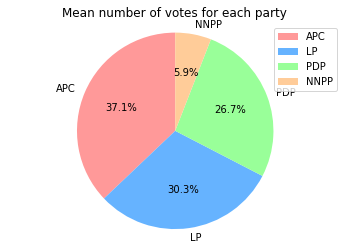

In [34]:
# Create a pie chart for the mean number of votes for each party
labels = ['APC', 'LP', 'PDP', 'NNPP']
sizes = party_means.values
colors = ['#ff9999', '#66b3ff', '#99ff99', '#ffcc99']
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)
plt.axis('equal')
plt.title('Mean number of votes for each party')
plt.legend()
plt.show()



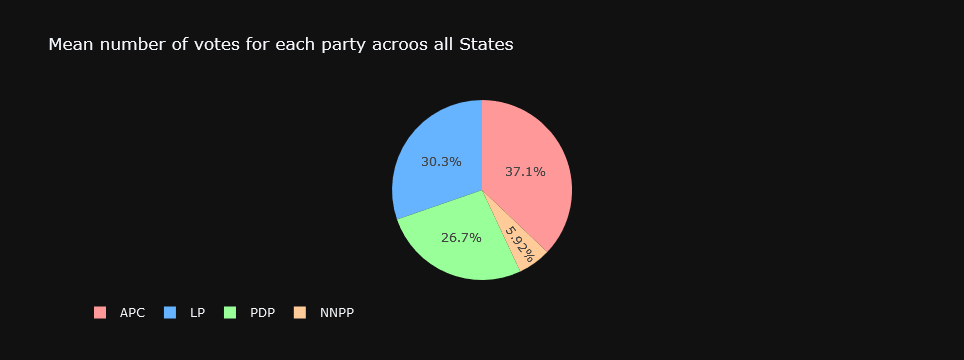

In [33]:
import plotly.graph_objs as go
labels = ['APC', 'LP', 'PDP', 'NNPP']
sizes = party_means.values
colors = ['#ff9999', '#66b3ff', '#99ff99', '#ffcc99']

fig = go.Figure(data=[go.Pie(labels=labels, values=sizes, textinfo='percent', 
                             marker=dict(colors=colors))])

fig.update_layout(title='Mean number of votes for each party acroos all States', 
                  template='plotly_dark', 
                  legend=dict(orientation='h'))

fig.show()

# Comparing the mean, standard deviation, minimum, and maximum values for each Voters accreditaton to see how they compare across different parties

In [ ]:
# df.groupby('Accredited_Voters').describe()


In [35]:
# Group by state and calculate summary statistics
grouped_df = df.groupby('Accredited_Voters')[['APC', 'PDP', 'LP', 'NNPP', 'Registered_Voters','Transcription_Count']].describe()

# Select relevant columns
stats_df = grouped_df[[('APC', 'mean'), ('APC', 'std'), ('APC', 'min'), ('APC', 'max'),
                       ('PDP', 'mean'), ('PDP', 'std'), ('PDP', 'min'), ('PDP', 'max'),
                       ('LP', 'mean'), ('LP', 'std'), ('LP', 'min'), ('LP', 'max'),
                       ('NNPP', 'mean'), ('NNPP', 'std'), ('NNPP', 'min'), ('NNPP', 'max'),
                       ('Registered_Voters', 'mean'),('Registered_Voters', 'std'),
                       ('Registered_Voters', 'min'),('Registered_Voters', 'max'),
                       ('Transcription_Count','mean'),('Transcription_Count','std'),
                       ('Transcription_Count','min'),('Transcription_Count','max')]]

# Rename columns
stats_df.columns = ['APC_mean', 'APC_std', 'APC_min', 'APC_max',
                    'PDP_mean', 'PDP_std', 'PDP_min', 'PDP_max',
                    'LP_mean', 'LP_std', 'LP_min', 'LP_max',
                    'NNPP_mean', 'NNPP_std', 'NNPP_min', 'NNPP_max',
                    'Registered_Voters_mean','Registered_Voters_std',
                    'Registered_Voters_min','Registered_Voters_max',
                    'Transcription_Count_mean','Transcription_Count_std',
                    'Transcription_Count_min','Transcription_Count_max']

# Get state with highest and lowest values for each column
highest = stats_df.idxmax()
lowest = stats_df.idxmin()

# Get the highest and lowest values for each state
highest_values = stats_df.max()
lowest_values = stats_df.min()

# Combine highest and lowest values into a single DataFrame
result_df = pd.concat([highest, highest_values, lowest, lowest_values], axis=1,
                      keys=['highest', 'highest_values', 'lowest', 'lowest_values'])

# Print table
print(tabulate(result_df, headers='keys', tablefmt='psql'))
# This code should print a table showing the state with the highest and lowest mean, standard deviation, minimum, and maximum values for APC, PDP, LP, and NNPP, as well as the actual highest and lowest values for each state.



+--------------------------+-----------+------------------+----------+-----------------+
|                          |   highest |   highest_values |   lowest |   lowest_values |
|--------------------------+-----------+------------------+----------+-----------------|
| APC_mean                 |       822 |          407     |      520 |           0     |
| APC_std                  |       551 |          314.663 |      520 |           0     |
| APC_min                  |       822 |          407     |        0 |           0     |
| APC_max                  |        14 |          600     |      520 |           0     |
| PDP_mean                 |       684 |          436     |      605 |           0     |
| PDP_std                  |       680 |          296.278 |      658 |           0     |
| PDP_min                  |       684 |          436     |        0 |           0     |
| PDP_max                  |       152 |          573     |      605 |           0     |
| LP_mean            

# Count of each party votes

Using this tabel Apc_mean is 822, LP_mean is 1052, pdp_mean is 684, NNPP_mean is 636, The higher mean accredited voters of LP  compared to other parties could suggest that LP has a larger voter population and may be more influential in determining election outcomes. Same thing is applicable id  use standard deviation.

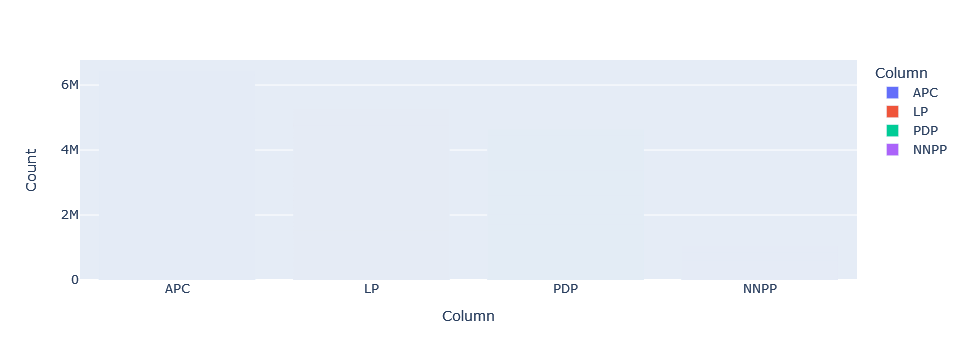

In [37]:
import pandas as pd
import plotly.express as px

# Select the desired columns
selected_columns = ['APC', 'LP','PDP', 'NNPP']
df_selected = df[selected_columns]

# Reshape the DataFrame
df_melted = df_selected.melt(var_name='Column', value_name='Count')

# Create the plot
fig = px.bar(df_melted, x='Column', y='Count', color='Column')
fig.show()


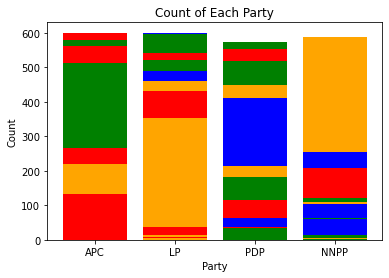

In [6]:
import pandas as pd
import matplotlib.pyplot as plt

# Select the desired columns
selected_columns = ['APC', 'LP', 'PDP', 'NNPP']
df_selected = df[selected_columns]

# Reshape the DataFrame
df_melted = df_selected.melt(var_name='Column', value_name='Count')

# Create the plot using matplotlib
plt.bar(df_melted['Column'], df_melted['Count'], color=['red', 'blue', 'green', 'orange'])

# Set the title and axis labels
plt.title('Count of Each Party')
plt.xlabel('Party')
plt.ylabel('Count')

# Show the plot
plt.show()

